<a href="https://colab.research.google.com/github/jing-zhang-jj/Data-Science-with-R---Capstone-Project/blob/main/IWeek_XAI_group_assignment.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Group Assignment

Please enter the number of your group here by editing the text field:



### Instructions

The assignment sheet contains 8 tasks that can be answered via textual responses and tasks that involve some low-level coding. Make sure that you distribute the tasks among group members equally. Please, indicate below who solved what task.

When you have finished the tasks, please send this sheet as well as the data directory via email as a zipped file to bettina.finzel@uni-bamberg.de. The name of the file should include your group number, for example "group1_submission.zip". The deadline for submission is 7.2.2025.

The solutions will be graded according to the following grading scheme:

7-8 tasks solved: grade 1

5-6 tasks solved: grade 2

3-4 tasks solved: grade 3

2 tasks solved: grade 4

1 task solved or less: failed

### Tasks solved by:

Task 1:

Task 2:

Task 3:

Task 4:

Task 5:

Task 6:

Task 7:

Task 8:



### Structure of the assignment

The first part of the assignment sheet contains the tasks descriptions. The second part of the assignment sheet contains the same code as used during the course. You can re-use it for the coding solutions of the assignment.

### Notes

Remember that you need to create a directory "data" in the file panel and store images there in order to make the code work. You also need to replace the name of the file in the code if you use a file named differently.

### First Part: Task Descriptions

Note: In order to give textual responses, simply create text fields in this script and fill them with your answer, for example "Solution to task 2: In picture XYZ, we think that the models sees..."

Task 1: Find 3 representative images in .jpg format (1 from medicine, 1 related to production, 1 related to autonomous driving) through searching the internet. You can search them on a platform of your choice. I recommend [unsplash](https://unsplash.com/de) as it contains free images. Upload them to the Google Colab project using the data directory.

Task 2: Create visual explanations for each image with the help of Grad-CAM based on this script. You may duplicate the code, such that your code script will contain all explanations for all 3 images at the same time. Then, shortly describe what you think that the models (ResNet50 and VGG19) are seeing in the images.

Task 3: Now, make predictions with both models for all 3 images. Again, you can duplicate the code, such that the predictions will be contained in the script for all 3 images at the same time. Then, answer the following question for each image: Is the prediction matching with your expectation of what the model sees?

Task 4 (creative task): Take one of the images and edit it slightly with a program of your choice (for example, you could draw dots and lines into the image, rotate it, make it noisy with the help of Paint, Photoshop etc.). Then, repeat the steps of explanation and prediction for this adapted image. Compare the results for the original image versus the adapted image. Did the results change? Submit the edited image and a short description of how you edited it and which changes in explanation and prediction you observed.

Task 5 (general question): Are visual explanations helpful? What are advantages and disadvantages? Name at least 2 aspects each.

Task 6: Which kind of explanation method can we use to make explanations for machine learning models more expressive? Name at least 1 example from the course content and shortly describe why it is more expressive than a mere visual explanation.

Task 7: Which kind of explanation method can we use to make explanations for machine learning models more human-centered? Name at least 2 examples from the course content and shortly describe why they are human-centered.

Task 8: Look at the taxonomy from the slides of part 1. How would you categorize Grad-CAM with this schema? Name all categories that apply to Grad-CAM (in hierarchical manner).

### Second Part: Code Template

### Installing the explainability library "easy-explain"

In [1]:
!pip install easy-explain

### Importing libraries required to make the code run and setup of paths

In [3]:
import warnings
warnings.filterwarnings('ignore')

import sys
import os

from torchvision.models import resnet50, vgg19
from torchvision.io.image import read_image

import torch

# Set up paths
module_path = os.path.abspath(os.path.join("/content/data/Grad_CAM_resnet50_vgg19 (1).ipynb"))
if module_path not in sys.path:
    sys.path.append(module_path)

from easy_explain import CAMExplain

### Loading two pre-trained CNN models (ResNet50 and VGG19) from PyTorch and setting them into a evaluable state

In [4]:
resnet50_model = resnet50(weights="ResNet50_Weights.DEFAULT").eval()
vgg19_model = vgg19(weights="VGG19_Weights.DEFAULT").eval()

### Define parameters for image transformation that will make input images fit the input expected by both models, pre-trained on the ImageNet data set

In [5]:
trans_params = {"ImageNet_transformation":
  {"Resize": {"h": 224,"w": 224},
  "Normalize": {"mean": [0.485, 0.456, 0.406], "std": [0.229, 0.224, 0.225]}}}

### Load an image of your choice (from the directory data)

You have to create the directory "data" first, to be able to store images there and to access them in the code.

In [6]:
img1 = read_image("/content/data/Brain-tumor-1-medicine.jpg")

In [7]:
img2 = read_image("/content/data/califlower-2-production.jpg")

In [8]:
img3 = read_image("/content/data/autonomous driving -3.jpg")

### Setup the CAMExplainer from the easy-explain library for the ResNet50 model

In [9]:
explainer = CAMExplain(model = resnet50_model)

## Making predictions with the models and explaining them for one image

You can find ImageNet labels for each class in [this repository](https://gist.github.com/yrevar/942d3a0ac09ec9e5eb3a).

In [15]:
img1 = img1.unsqueeze(0) # only when predicting

In [16]:
img2 = img2.unsqueeze(0) # only when predicting

In [17]:
img3 = img3.unsqueeze(0) # only when predicting

In [10]:
input_tensor1 = explainer.transform_image(img1, trans_params["ImageNet_transformation"])

In [11]:
input_tensor2 = explainer.transform_image(img2, trans_params["ImageNet_transformation"])

In [12]:
input_tensor3 = explainer.transform_image(img3, trans_params["ImageNet_transformation"])

In [19]:
output1 = resnet50_model(input_tensor1) # only when predicting

prediction1 = int(torch.max(output1.data, 1)[1].numpy()) # only when predicting
print(prediction1) # only when predicting

ValueError: expected 4D input (got 3D input)

In [14]:
output2 = resnet50_model(input_tensor2) # only when predicting

prediction2 = int(torch.max(output2.data, 1)[1].numpy()) # only when predicting
print(prediction2) # only when predicting

ValueError: expected 4D input (got 3D input)

In [ ]:
output3 = resnet50_model(input_tensor3) # only when predicting

prediction3 = int(torch.max(output3.data, 1)[1].numpy()) # only when predicting
print(prediction3) # only when predicting

In [14]:
print(resnet50_model)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

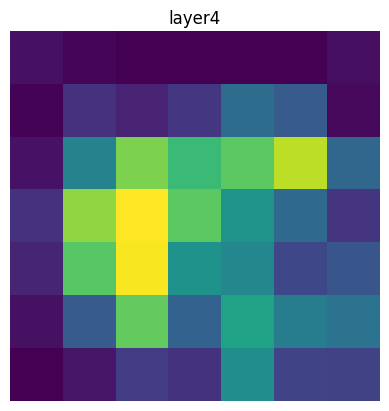

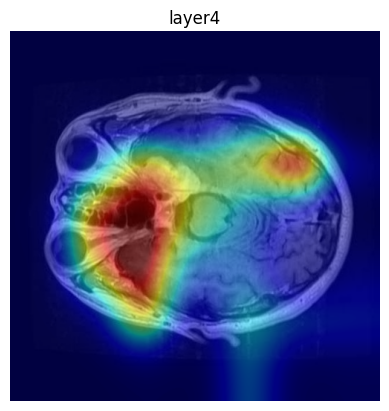

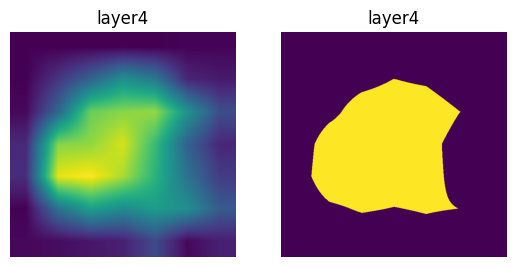

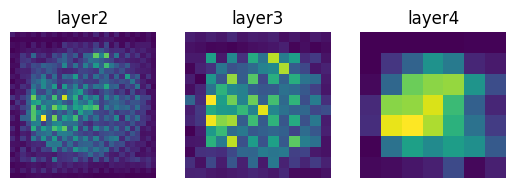

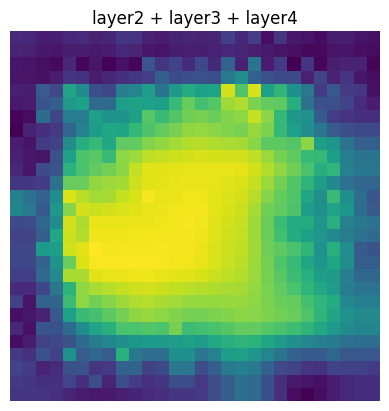

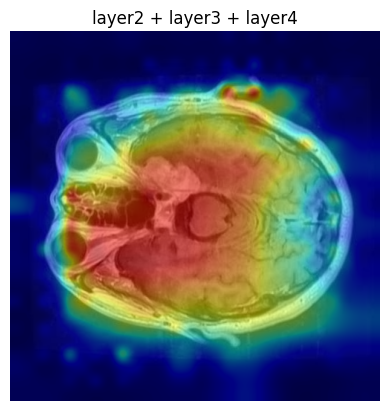

In [15]:
explainer.generate_explanation(img1, input_tensor1, multiple_layers=["layer2", "layer3", "layer4"])

In the picture of ResNet50 which represented an horizontal heatmap overlay of the brain scan taken from the top looking down for the purpose of brain tumor, through a feature visualization or activation map from layers 2, 3, and 4, we observed red areas indicate regions of highest activation/attention from the network. Yellow and green areas show moderate activation.
Blue areas represent lower activation or attention from the network. The skull outline is visible as a lighter boundary around the brain tissue, showing in cyan/blue colors in this visualization.
However, since this is a CNN activation map overlay, it's important to note that the colors represent the network's attention rather than actual anatomical structures or pathology. The underlying brain scan appears to be from a typical MRI or CT axial slice at roughly mid-brain level.

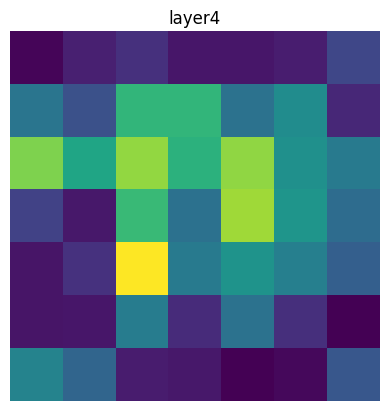

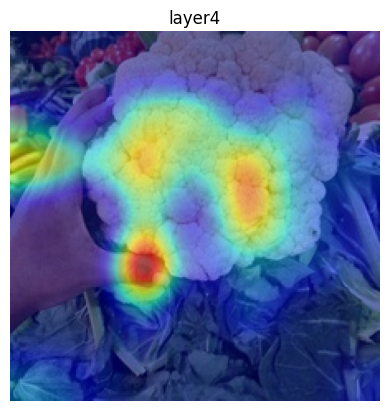

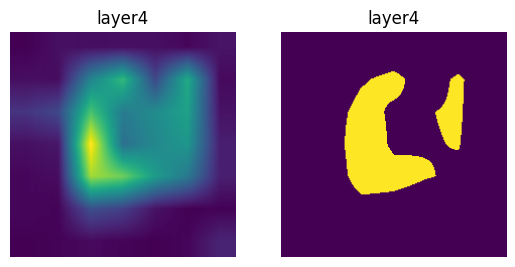

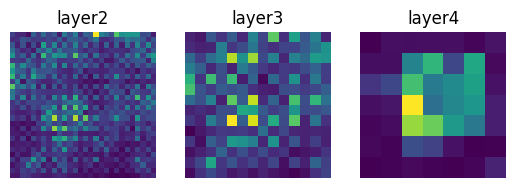

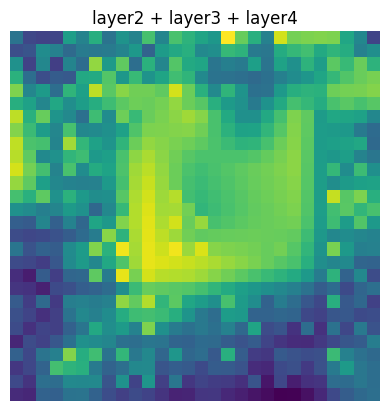

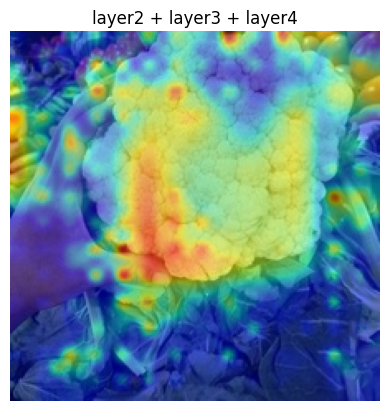

In [16]:
explainer.generate_explanation(img2, input_tensor2, multiple_layers=["layer2", "layer3", "layer4"])

For the second model of ResNet50 activation map overlay (combining layers 2, 3, and 4) about cauliflower, the heat map shows strong activation (red/orange) around certain textural features, particularly on one side of the vegetable. Moderate activation (yellow/green) across the central mass of what appears to be the cauliflower head. Low activation (blue/purple) in the background and peripheral areas.
The CNN appears to be paying particular attention to the textural patterns characteristic of cauliflower's florets and the boundary regions between the vegetable and the background and some specific features or edges within the vegetable structure.
This visualization demonstrates how the CNN's early and middle layers are processing features like edges, textures, and patterns that are characteristic of the object. The combined activation from layers 2, 3, and 4 shows how the network builds up its understanding of the image from these different levels of feature detection.

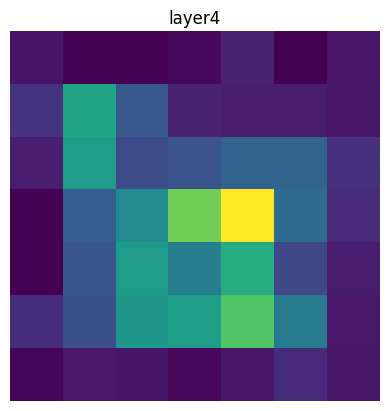

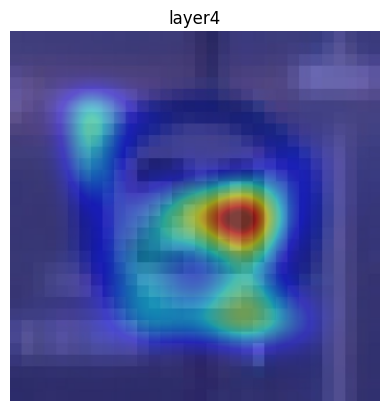

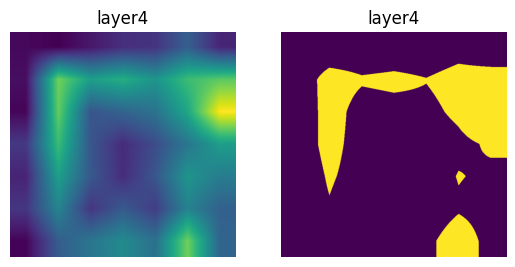

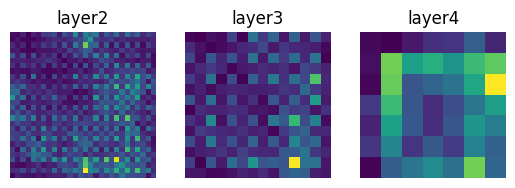

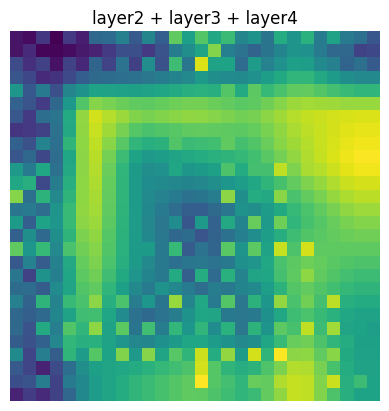

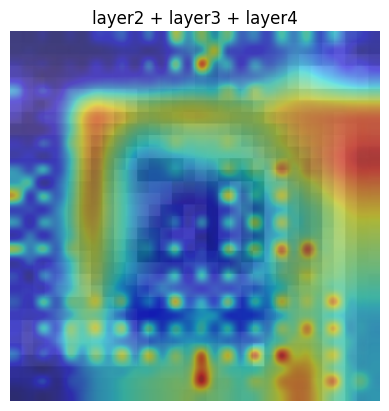

In [17]:
explainer.generate_explanation(img3, input_tensor3, multiple_layers=["layer2", "layer3", "layer4"])

Image 3 showed a ResNet50 CNN activation map (combining layers 2, 3, and 4) of what appears to be a speed limit sign, the network paying particular attention to the circular border of the sign (shown in yellow/orange activation) and the digits "20" in the center (shown as darker blue with surrounding activation patterns) and strong activation (red) in certain corner regions and edges.
The activation map demonstrates how the CNN is processing the key visual elements strong edge detection around the circular shape and recognition of the numerical characters and focus on the contrast between the numbers and background and attention to the distinctive features that make this recognizable as a traffic sign.

In [18]:
explainer = CAMExplain(model = vgg19_model)

In [19]:
vgg19_model

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padd

In [20]:
input_tensor1 = explainer.transform_image(img1, trans_params["ImageNet_transformation"])

In [21]:
input_tensor2 = explainer.transform_image(img2, trans_params["ImageNet_transformation"])

In [22]:
input_tensor3 = explainer.transform_image(img3, trans_params["ImageNet_transformation"])

In [ ]:
output1 = vgg19_model(input_tensor1) # only when predicting

prediction1 = int(torch.max(output.data, 1)[1].numpy()) # only when predicting
print(prediction1) # only when predicting

In [ ]:
output2 = vgg19_model(input_tensor2) # only when predicting

prediction2 = int(torch.max(output.data, 1)[1].numpy()) # only when predicting
print(prediction2) # only when predicting

In [ ]:
output3 = vgg19_model(input_tensor3) # only when predicting

prediction3 = int(torch.max(output.data, 1)[1].numpy()) # only when predicting
print(prediction3) # only when predicting

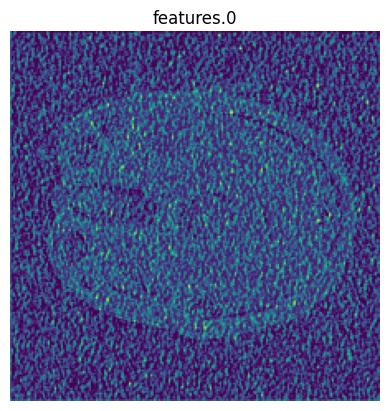

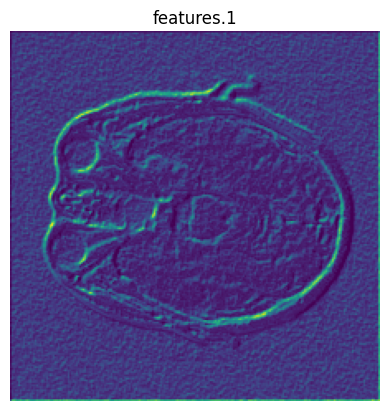

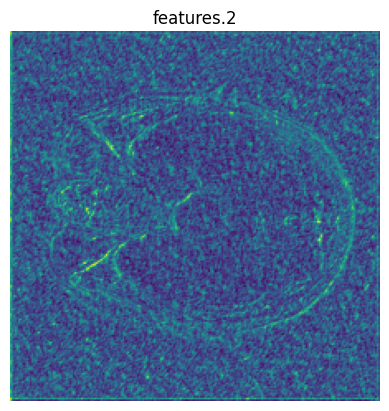

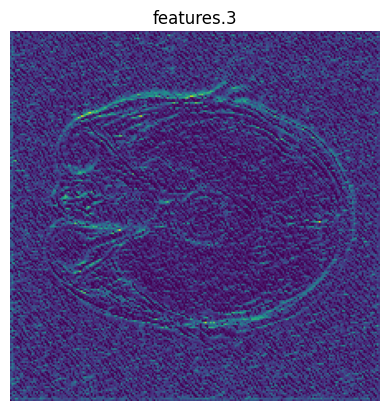

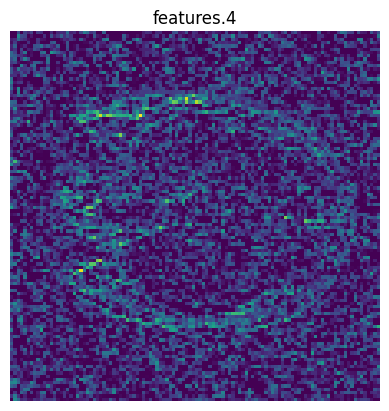

...

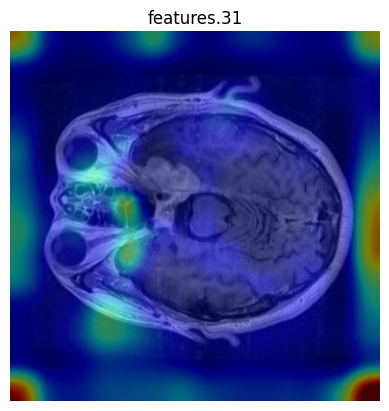

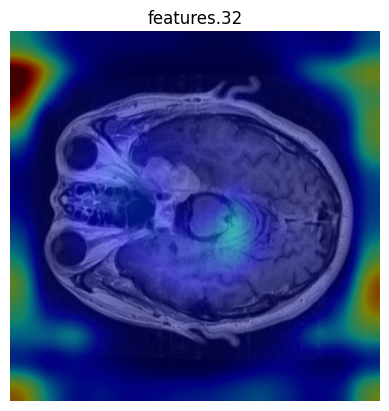

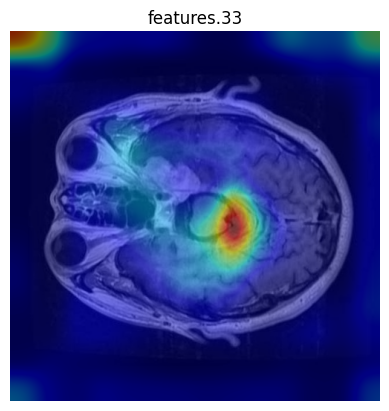

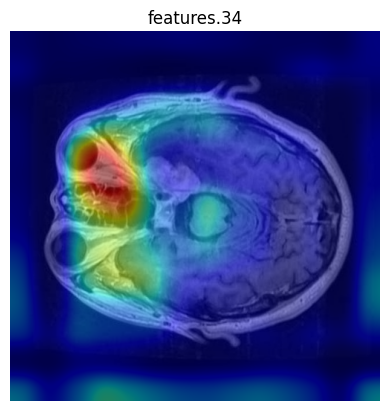

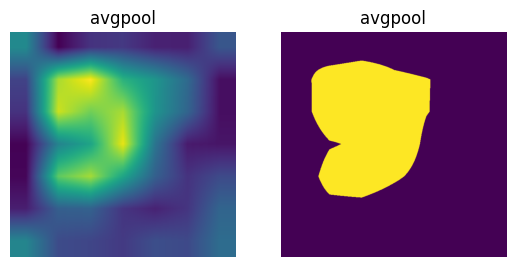

In [23]:
# Keep the features layers until the last CNN layer
features = []
features = [vgg19_model.features[x] for x in range(35)]

explainer.generate_explanation(img1, input_tensor1, target_layer=features)

From vgg 19 which interpreted what appears to be a brain MRI scan, for feature 33, it shows strong activation (red/yellow) in the central region of the brain and focuses on what appears to be a specific anatomical structure in the mid-brain area and the activation is more concentrated and localized compared to features.34. And for feature 34, it shows strong activation (red/yellow) in the frontal region of the brain

The activation pattern is more spread out in the anterior (front) portion and Demonstrates different feature detection compared to features.33. This sequence of visualizations demonstrates how different layers in the VGG-19 network process and detect different features in the brain scan, with earlier layers (33, 34) showing more specific localized features, while the avgpool layer shows a more abstracted, summarized representation.



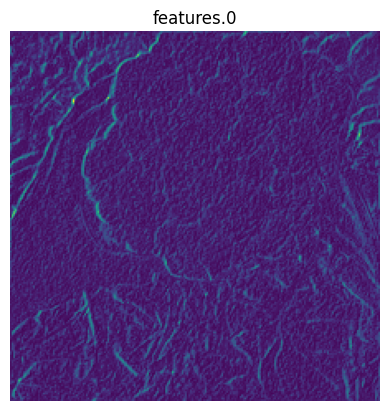

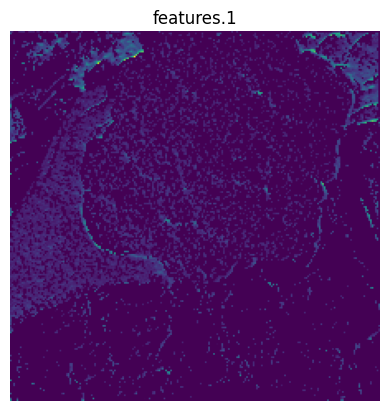

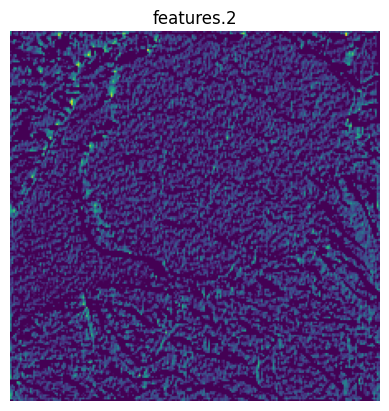

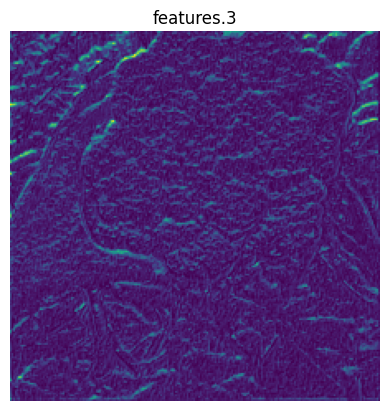

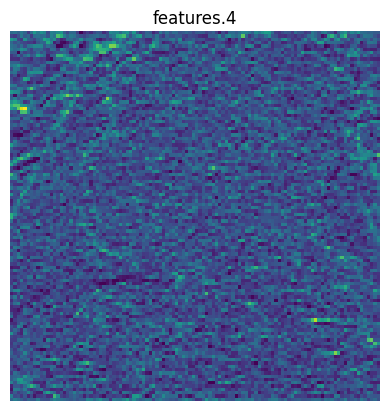

...

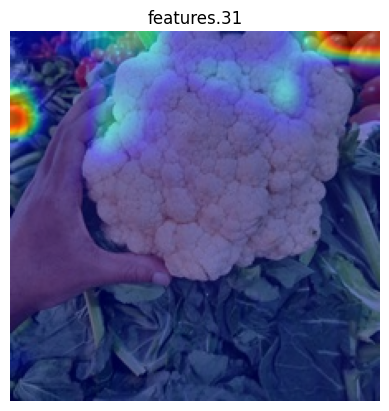

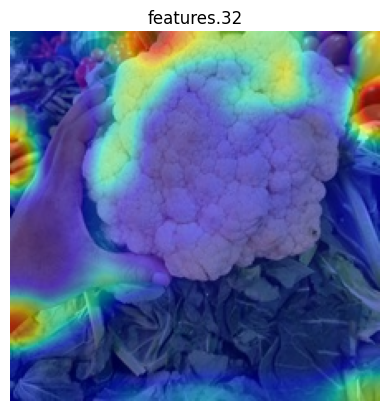

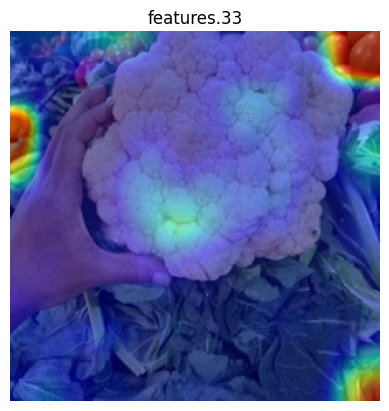

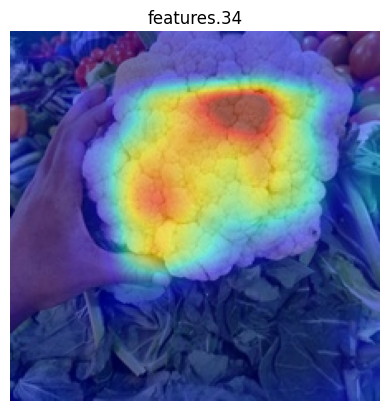

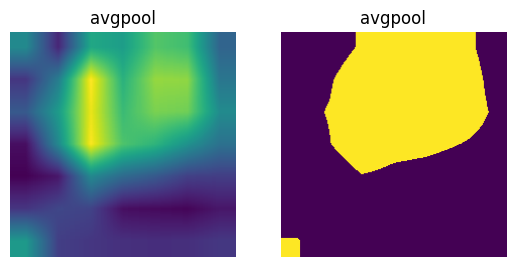

In [24]:
# Keep the features layers until the last CNN layer
features = []
features = [vgg19_model.features[x] for x in range(35)]

explainer.generate_explanation(img2, input_tensor2, target_layer=features)

For the cauliflower of vgg 19 layers, about features.34, this is block5_conv3 and one of the deepest convolutional layers in VGG-19 and shows the most sophisticated feature detection and strong activation across the cauliflower's surface, suggesting it has learned to recognize the characteristic "cauliflower pattern".

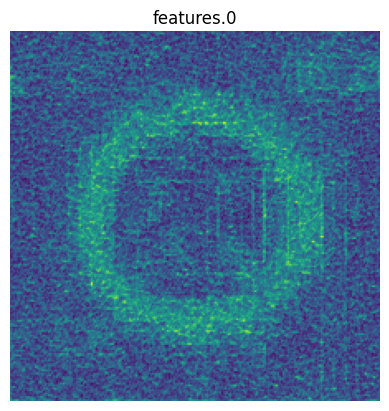

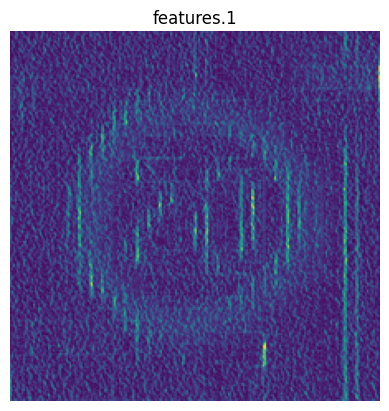

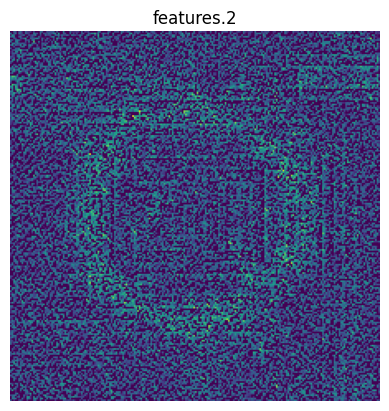

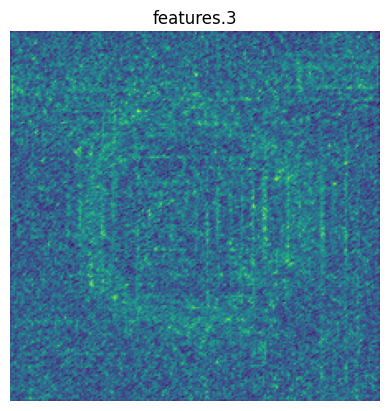

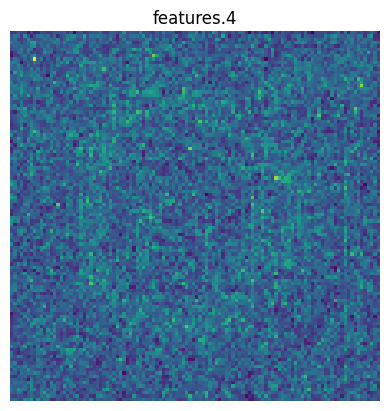

...

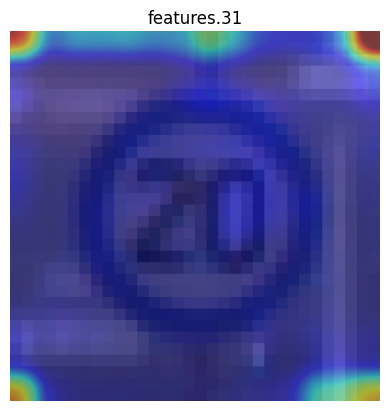

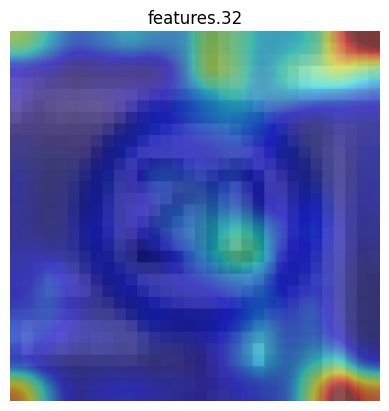

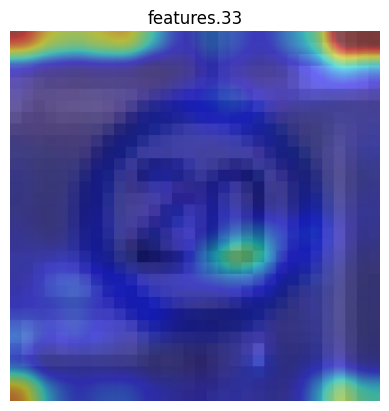

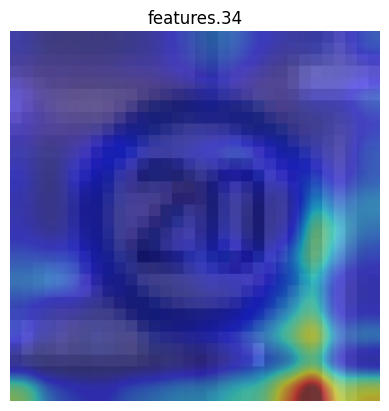

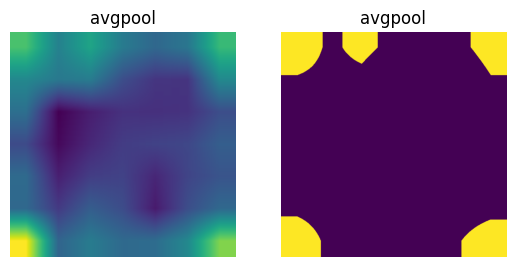

In [25]:
# Keep the features layers until the last CNN layer
features = []
features = [vgg19_model.features[x] for x in range(35)]

explainer.generate_explanation(img3, input_tensor3, target_layer=features)

For the a speed limit "20" sign, in this deep convolutional layer (block5_conv3), it shows structure recognition and the circular shape of the speed sign is still recognizable in dark blue and the "20" numerals are visible in the center, though pixelated due to the deep layer processing. For activation patterns, it described strong activation (red/yellow) appears in the bottom right corner and moderate activation (green/cyan) forms a pattern along the right side and lower activation (dark blue) in the main sign area and background.

This layer (features.34) is one of the deepest convolutional layers in VGG-19, so it's looking for very specific, high-level features. The strong activation in the corner suggests this layer might be particularly sensitive to certain edge combinations or contextual features that help identify traffic signs.